# Autonomous Mixing Notebook

In [1]:
import numpy as np
from preprocessing import *
from equalization import *
from scipy.signal import iirnotch, lfilter
from scipy.stats import rankdata
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
%matplotlib inline

## Real audio dataset

In [2]:
signals = ['audio_data/bass.wav', 'audio_data/drums.wav', 'audio_data/other.wav', 'audio_data/vocals.wav']

In [3]:
def mask(signal_a, signals, rank_threshold, sr, max_n):
    mask = np.array([])
    mask_info = []
    masker_fft = fft_avg(signal_a, sr)
    maskee_ffts = [fft_avg(signal, sr) for signal in signals]
    masker_rank = rank_signal_1d(masker_fft)
    maskee_ranks = [rank_signal_1d(maskee_fft) for maskee_fft in maskee_ffts]
    masker_rank_mat = np.where(masker_rank > rank_threshold, 1, 0)
    num_bins = masker_fft.shape[0]
    for i in range(len(signals)):
        maskee_fft = maskee_ffts[i]
        maskee_rank = maskee_ranks[i]
        maskee_rank_mat = np.where(maskee_rank <= 10, 1, 0)
        mask_ab = (masker_rank_mat * maskee_rank_mat) * (masker_fft - maskee_fft)
        mask = np.append(mask, mask_ab)
    top_m = np.argsort(mask)[-max_n:]
    idx = np.unravel_index(top_m, mask.shape)[0]
    for i in idx:
        freq_bin = (i % num_bins) * (sr / num_bins)
        mask_val = mask[i]
        if mask_val > 0:
            mask_info.append([freq_bin, mask_val])
    return np.array(mask_info)

In [4]:
mask(signals[3], [signals[i] for i in range(len(signals)) if i !=3], 10, 44100, 3)

array([[687.71929825,   1.43586826],
       [773.68421053,   5.53002453],
       [859.64912281,  11.20419216]])

# Pyo EQ

In [5]:
from pyo import *

In [6]:
s = Server().boot()

Pyo warning: Portaudio input device `G Money Bose` has fewer channels (1) than requested (2).
Pyo warning: Portmidi warning: no midi device found!
Portmidi closed.


In [15]:
s.start()

Pyo warning: Server already started!


In [16]:
vocals = SfPlayer(signals[3])

In [19]:
vocals.play()

< Instance of SfPlayer class >

In [17]:
vocals_out = EQ(vocals, freq=687.72, boost=-1.44, type=0).out()

In [70]:
vocals_out = EQ(vocals_out, freq=773.68, boost=-5.53, type=0).out()

In [66]:
vocals_out = EQ(vocals_out, freq=859.65, boost=-11.2, type=0).out()

In [18]:
vocals_out.play()

< Instance of EQ class >

In [20]:
s.stop()

# Old testing

In [12]:
offline_fmag(signals[0], 44100)

array([[ 12.933942 , -15.54042  , -39.585712 , ..., -17.650301 ,
        -21.699612 , -19.698097 ],
       [ 13.455696 ,  -2.9365458,  -4.031034 , ..., -15.461221 ,
        -12.430343 ,  -8.012332 ],
       [ 21.947247 ,  12.91124  ,  12.807247 , ...,  19.130297 ,
         19.004612 ,  19.318579 ],
       ...,
       [-46.76925  , -46.76925  , -45.18854  , ..., -46.76925  ,
        -46.76925  , -46.76925  ],
       [-46.76925  , -46.76925  , -45.205376 , ..., -46.76925  ,
        -46.76925  , -46.76925  ],
       [-46.76925  , -46.76925  , -46.76925  , ..., -46.76925  ,
        -46.76925  , -43.473873 ]], dtype=float32)

In [131]:
def offline_fmag_test(audio_signal, sr):
    y, sr = librosa.load(audio_signal, sr=sr)
    D = np.abs(librosa.core.stft(y, n_fft=1024, hop_length=1024))
    D_db = librosa.amplitude_to_db(D)
    return np.mean(D_db, axis=1)

In [15]:
def rank_signal_1d(audio_signal):
    return np.abs(rankdata(audio_signal, method='ordinal') - (audio_signal.shape[0] - 1))

In [10]:
def eq_params_test(signals, rank_threshold, sr, top_n):
    '''
    This function returns a list of parameters that can be used during
    the equalization process. 

    The input for this function is a list of
    loaded audio signals, the rank threshold for the masking formula,
    the sample rate, and the number of top mask values to return. 

    For the top x occurences of masking within a frequency, the function 
    returns their signal index, frequency bin,
    and the value of the masking function.
    '''
    n = len(signals)
    fft_signals = [offline_fmag(signal, sr) for signal in signals]
    rank_signals = [rank_freq_regions(fft_signal) for fft_signal in fft_signals]
    mask_info = []
    for i in range(n):
        for j in range(n-1):
            sig_a = fft_signals[i]
            sig_b = fft_signals[(i + j + 1) % n]
            print(sig_a - sig_b)
            rank_a = rank_signals[i]
            rank_b = rank_signals[(i+j+1) % n]
            # creates boolean matrices that return 1 or 0 based on the rank threshold
            r_a = np.where(rank_a > rank_threshold, 1, 0)
            r_b = np.where(rank_b <= rank_threshold, 1, 0)
            print(r_b * r_a)
            print()
            # uses elementwise multiplication between the boolean matrices and frequency
            # signals to calculate the spectral masking for all values that meet the rank
            # threshold conditions
            v = (r_a*r_b)*(sig_a - sig_b)
            print(v)
            print(np.amax(v), np.amin(v))
            # flattens matrix to find the top_n values and appends the signal
            # index, freq_bin, and mask value to the mask_info list
            v_1d = v.flatten()
            idx_1d = v_1d.argsort()[-top_n:]
            x_idx, y_idx = np.unravel_index(idx_1d, v.shape)
            for x, y, in zip(x_idx, y_idx):
                freq_bin = x * (sr / v.shape[0])
                mask_ab = v[x][y]
                mask_info.append([i, freq_bin, mask_ab])
    return mask_info

In [118]:
t = offline_fmag_test(signals[1], 44100)
t1 = offline_fmag_test(signals[3], 44100)

In [119]:
t.shape

(513, 1897)

In [105]:
t1[0:50]

array([ -7.94195  ,  -7.832977 , -12.365414 , -16.236708 , -10.208078 ,
        -3.834951 ,  -3.0551708,  -7.8725405, -14.419826 , -15.811576 ,
       -12.957765 ,  -9.993314 ,  -9.595467 , -11.197316 , -13.601544 ,
       -13.217598 , -12.685444 , -11.9936695, -12.937254 , -13.855729 ,
       -15.198386 , -15.572745 , -16.461857 , -17.241802 , -17.27819  ,
       -17.14466  , -17.519762 , -18.032682 , -18.763346 , -19.368284 ,
       -19.501589 , -18.800703 , -18.525362 , -18.553383 , -18.997232 ,
       -18.22325  , -17.055855 , -16.693718 , -17.997538 , -19.615559 ,
       -19.567186 , -19.416687 , -19.1394   , -19.485897 , -20.30621  ,
       -21.4627   , -22.43408  , -21.539465 , -20.277058 , -20.43425  ],
      dtype=float32)

In [106]:
t[0:50]

array([ -0.30414715,   2.225718  ,   0.3860377 ,  -0.5101624 ,
        -2.1361055 ,  -0.8932674 ,  -4.0155535 , -10.741788  ,
       -11.322372  ,  -9.572241  ,  -9.974119  , -12.338598  ,
       -12.371138  , -13.09644   , -14.22621   , -16.378918  ,
       -17.809935  , -19.44104   , -19.925     , -18.740362  ,
       -16.736322  , -17.175732  , -20.430294  , -23.160015  ,
       -19.827175  , -19.339817  , -21.21272   , -22.636074  ,
       -22.154808  , -22.269613  , -21.851868  , -22.087353  ,
       -21.687258  , -22.72331   , -22.5587    , -22.225147  ,
       -22.731016  , -23.546171  , -23.408054  , -22.932766  ,
       -24.38154   , -24.385674  , -22.948465  , -22.54701   ,
       -23.011604  , -23.070524  , -21.855673  , -22.410038  ,
       -23.372295  , -23.090597  ], dtype=float32)

In [107]:
r = rank_signal_1d(t)
r1 = rank_signal_1d(t1)

In [108]:
r_a = np.where(r > 10, 1, 0)
r1_a = np.where(r1 <= 10, 1, 0)
r_b = np.where(r <= 10, 1, 0)
r1_b = np.where(r1 > 10, 1, 0)

In [109]:
r_a

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

In [110]:
r1_a

array([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [111]:
r_a * r1_a

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [112]:
m = (r_a * r1_a) * (t - t1)

In [113]:
np.amax(m), np.amin(m)

(0.0, -7.447370529174805)

In [114]:
m1 = (r_b * r1_b) * (t1 - t)

In [115]:
np.amax(m1), np.amin(m1)

(-0.0, -15.726545333862305)

In [116]:
m1[0:50]

array([ -0.        ,  -0.        ,  -0.        , -15.72654533,
        -0.        ,  -0.        ,   0.        ,   0.        ,
        -3.09745312,  -6.23933506,  -2.98364544,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        ,   0.        ,
         0.        ,   0.        ,  -0.        ,   0.        ,
         0.        ,   0.        ])

# Jazz Audio

In [128]:
path = 'jazz_audio/'
sigs = [path+'01_KickIn.wav', path+'02_KickOut.wav', path+'03_Snare.wav', path+'08_BassDI.wav', path+'09_ElecGtrMic1.wav',
       path+'10_ElecGtrMic2.wav', path+'11_Piano.wav']

In [129]:
sigs

['jazz_audio/01_KickIn.wav',
 'jazz_audio/02_KickOut.wav',
 'jazz_audio/03_Snare.wav',
 'jazz_audio/08_BassDI.wav',
 'jazz_audio/09_ElecGtrMic1.wav',
 'jazz_audio/10_ElecGtrMic2.wav',
 'jazz_audio/11_Piano.wav']

In [150]:
s = offline_fmag_test(sigs[0], 44100)
s1 = offline_fmag_test(sigs[1], 44100)

In [151]:
r = rank_signal_1d(s)
r1 = rank_signal_1d(s1)
r_a = np.where(r > 10, 1, 0)
r1_a = np.where(r1 <= 10, 1, 0)
r_b = np.where(r <= 10, 1, 0)
r1_b = np.where(r1 > 10, 1, 0)

In [152]:
r_a*r1_a

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [153]:
m = (r_a * r1_a) * (s - s1)

In [154]:
m

array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -8.27054024, -9.27667999, -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.  

In [155]:
m1 = (r_b * r1_b) * (s1 - s)

In [156]:
m1

array([-0.        , -0.        , -0.        , -0.        , -0.        ,
        0.        ,  0.        ,  5.05595016,  5.02918243,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.  

# Test Functions

In [5]:
eq_params(signals, 10, 44100, 1)

[[0, 430.2439024390244, 14.78182601928711],
 [0, 645.3658536585366, 3.305011749267578],
 [0, 559.3170731707316, 37.6431884765625],
 [1, 387.2195121951219, 33.61457061767578],
 [1, 473.2682926829268, 44.14434051513672],
 [1, 0.0, 45.12694549560547],
 [2, 817.4634146341464, 50.38565444946289],
 [2, 430.2439024390244, 50.067039489746094],
 [2, 387.2195121951219, 30.06519317626953],
 [3, 516.2926829268292, 46.33357238769531],
 [3, 43.02439024390244, 28.134706497192383],
 [3, 4216.390243902439, 24.573223114013672]]

In [11]:
eq_params_test(signals, 10, 44100, 1)

[[ 16.901674     9.349252   -15.48933    ... -15.441194   -11.959069
   -4.2628107 ]
 [ 17.348907    12.880018    16.43024    ... -12.1530285    0.07144451
   10.658681  ]
 [ 46.310867    16.736246    22.597486   ...  27.355713    26.38871
   39.951103  ]
 ...
 [-26.669397   -13.133163    -5.67083    ...  -7.2515373   -7.2515373
   -7.2515373 ]
 [-23.77266     -9.898323   -16.881233   ...  -7.2515373   -7.2515373
   -7.2515373 ]
 [-21.370869    -7.2515373  -20.454037   ...  -7.2515373   -7.2515373
   -3.9561615 ]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

[[ 0.  0. -0. ... -0. -0. -0.]
 [ 0.  0.  0. ... -0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 ...
 [-0. -0. -0. ... -0. -0. -0.]
 [-0. -0. -0. ... -0. -0. -0.]
 [-0. -0. -0. ... -0. -0. -0.]]
14.78182601928711 -74.53467559814453
[[  5.994585    8.6764345 -16.26139   ...  -5.0433664 -14.945963
   20.753563 ]
 [  6.445469   23.046194   12.534138  ...   0.6156

[[0, 430.2439024390244, 14.78182601928711],
 [0, 645.3658536585366, 3.305011749267578],
 [0, 559.3170731707316, 37.6431884765625],
 [1, 387.2195121951219, 33.61457061767578],
 [1, 473.2682926829268, 44.14434051513672],
 [1, 0.0, 45.12694549560547],
 [2, 817.4634146341464, 50.38565444946289],
 [2, 430.2439024390244, 50.067039489746094],
 [2, 387.2195121951219, 30.06519317626953],
 [3, 516.2926829268292, 46.33357238769531],
 [3, 43.02439024390244, 28.134706497192383],
 [3, 4216.390243902439, 24.573223114013672]]

# Practice

In [21]:
test, sr = librosa.load(signals[0], sr=44100)

In [22]:
test

array([-0.05967712, -0.05911255, -0.05841064, ..., -0.00796509,
       -0.00762939, -0.00737   ], dtype=float32)

In [43]:
np.amin(test)

-0.22912598

In [35]:
test_fft = librosa.core.stft(test, hop_length=1024)

In [36]:
test_ifft = librosa.core.istft(test_fft, hop_length=1024)

In [37]:
test_ifft

array([-0.05967712, -0.05911255, -0.05841064, ..., -0.00842285,
       -0.0085144 , -0.00869751], dtype=float32)

In [38]:
scipy.io.wavfile.write('ifft.wav', 44100, test_ifft)

In [39]:
ipd.Audio('ifft.wav')

In [4]:
s0 = offline_fmag(signals[0], sr=44100)
s1 = offline_fmag(signals[1], sr=44100)

In [57]:
a, sr_a = librosa.load(signals[0], sr=44100)
b, sr_b = librosa.load(signals[1], sr=44100)
D_a = np.abs(librosa.core.stft(a, hop_length=1024))
D_b = np.abs(librosa.core.stft(b, hop_length=1024))

In [81]:
D_a.shape

(1025, 1897)

In [64]:
D_a_mu = np.mean(D_a, axis=0)
D_b_mu = np.mean(D_b, axis=0)

In [66]:
np.amin(D_a_mu), np.amax(D_a_mu)

(0.00077736436, 0.25656778)

In [82]:
np.amin(D_a), np.argmax(D_a, axis=0), np.median(D_a)

(3.5213873e-07, array([3, 3, 3, ..., 3, 3, 3]), 0.0005393017)

In [63]:
np.amin(a), np.amax(a), np.median(a)

(-0.22912598, 0.14416504, 0.005935669)

In [79]:
np.amax(D_a_mu)

0.25656778

In [77]:
librosa.amplitude_to_db(D_a_mu)

array([-20.492786, -20.222979, -20.408762, ..., -19.22896 , -19.413994,
       -19.471653], dtype=float32)

# Trial

In [44]:
m_s0 = np.mean(s0, axis=0)
m_s1 = np.mean(s1, axis=0)

In [45]:
m_s0.shape

(1897,)

In [68]:
rank_s0 = np.abs(scipy.stats.rankdata(m_s0, method='ordinal') - (m_s0.shape[0] - 1))
rank_s1 = np.abs(scipy.stats.rankdata(m_s1, method='ordinal') - (m_s1.shape[0] - 1))

In [69]:
r_s0 = np.where(rank_s0 > 10, 1, 0)
r_s1 = np.where(rank_s1 <= 10, 1, 0)

In [76]:
np.amin(m_s0)

-46.75817

In [52]:
np.abs((m_s0*r_s0)) - np.abs((m_s1*r_s1))

array([43.90589523, 45.19813538, 45.30934143, ..., 45.1078186 ,
       45.16559982, 45.15314484])

In [54]:
m_s0[0], m_s1[0]

(-43.905895, -18.487793)

# New thing

In [5]:
s0.shape

(1025, 1897)

In [7]:
rank_s0, rank_s1 = rank_freq_regions(s0), rank_freq_regions(s1)

In [10]:
s0[rank_s0 == 1]

array([-33.34173 , -30.93542 , -30.86621 , ...,  19.287798,  18.786116,
        18.273405], dtype=float32)

In [19]:
s0_b = np.where(rank_s0 >= 10, 1, 0)
s1_b = np.where(rank_s1 < 10, 1, 0)

In [18]:
s0_b

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 0, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]])

In [20]:
v = np.multiply(s0, s0_b) - np.multiply(s1, s1_b)

In [22]:
v[v == 0].shape

(7224,)

In [6]:
fft_signals = [offline_fmag(signal, 44100) for signal in signals]
rank_signals = [rank_freq_regions(fft_signal) for fft_signal in fft_signals]

In [43]:
np.amax(fft_signals[1]), np.amin(fft_signals[1])

(36.83361, -43.16639)

In [7]:
n = len(fft_signals)
mask_info = []
for i in range(n):
    for j in range(n-1):
        sig_a = fft_signals[i]
        sig_b = fft_signals[(i + j + 1) % n]
        rank_a = rank_signals[i]
        rank_b = rank_signals[(i+j+1) % n]
        r_a = np.where(rank_a > 10, 1, 0)
        r_b = np.where(rank_b <= 10, 1, 0)
        v = (sig_a * r_a) - (sig_b * r_b)
        v_1d = v.flatten()
        idx_1d = v_1d.argsort()[-1:]
        x_idx, y_idx = np.unravel_index(idx_1d, v.shape)
        for x, y, in zip(x_idx, y_idx):
            freq_bin = x * (44100 / v.shape[0])
            mask_ab = v[x][y]
            mask_info.append([i, freq_bin, mask_ab])

In [8]:
mask_info[0]

[0, 430.2439024390244, 26.38141441345215]

In [9]:
freq_eq = [mask_info[0][1], mask_info[1][1],mask_info[2][1]]
gain_eq = [mask_info[0][2], mask_info[1][2],mask_info[2][2]]
# gain_eq[0].dtype
eq_fft = three_band_equalizer(s0, 44100.0, freq_eq, 2.0, gain_eq)

In [10]:
eq_fft.shape

(1025, 1897)

In [11]:
eq_s0 = librosa.core.istft(eq_fft, hop_length=1024)

In [12]:
eq_s0.shape

(1941504,)

In [40]:
eq_s0a = librosa.core.amplitude_to_db(eq_s0)

In [41]:
scipy.io.wavfile.write('test.wav', 44100, eq_s0)

In [42]:
ipd.Audio('test.wav')

In [67]:
def iir_bandpass(signal, freq, Q, fs):
    b, a = iirnotch(freq, Q, fs)
    y = lfilter(b, a, signal)
    return y

In [71]:
iir_bandpass(s0, freq_eq[0], 2.0, 44100.0)

array([[  5.93829628, -22.87900843,  -3.10705837, ..., -21.57516828,
        -29.29851433, -22.93712778],
       [  6.29164036, -17.18770492,   4.24744726, ..., -25.09062055,
        -23.37193118, -20.79883009],
       [  6.8853031 , -25.14526528,   9.54397451, ..., -21.99089101,
        -26.50044858, -19.45850038],
       ...,
       [-26.71038158, -45.96021081, -45.12424206, ..., -46.8706303 ,
        -46.87075256, -46.87087655],
       [-26.71188221, -45.96018348, -45.12421529, ..., -46.8706303 ,
        -46.87075256, -46.87087655],
       [-26.71247945, -45.9601726 , -45.12420463, ..., -46.8706303 ,
        -46.87075257, -46.87087656]])

In [70]:
signals[0]

'audio_data/bass.wav'

In [3]:
processing(signals, 10, 44100)

TypeError: 'int' object is not iterable

In [8]:
s0

array([[  5.9929   , -22.980251 ,  -3.4471843, ..., -23.33642  ,
        -31.148067 , -24.885004 ],
       [  6.349493 , -17.230122 ,   4.086022 , ..., -26.557634 ,
        -25.039906 , -22.626045 ],
       [  6.9486146, -25.249943 ,   9.295897 , ..., -23.055199 ,
        -27.862223 , -21.092613 ],
       ...,
       [-26.955988 , -46.873703 , -46.873703 , ..., -46.873703 ,
        -46.873703 , -46.873703 ],
       [-26.957502 , -46.873703 , -46.873703 , ..., -46.873703 ,
        -46.873703 , -46.873703 ],
       [-26.958105 , -46.873703 , -46.873703 , ..., -46.873703 ,
        -46.873703 , -46.873703 ]], dtype=float32)

In [10]:
rank_s0 = rank_freq_regions(s0)

In [14]:
rank_s0.shape

(1025, 949)

In [20]:
rank_s0 < 10

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False,  True, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [9]:
masking_formula(s0, s1, 4, 5, 10, 44100)

0

## Practice

In [2]:
filename = librosa.util.example_audio_file()

In [3]:
filename

'/anaconda3/envs/audio/lib/python3.5/site-packages/librosa/util/example_data/Kevin_MacLeod_-_Vibe_Ace.ogg'

In [4]:
y, sr = librosa.load(filename)

In [15]:
fft_y = np.abs(librosa.core.stft(y, hop_length=1024))

In [16]:
fft_y.shape

(1025, 1324)

In [18]:
freq_signals = [offline_fmag(file) for file in [filename, filename, filename]]

In [22]:
freq_signals[0]

array([-73.88941 , -21.528847, -12.495948, ..., -73.88941 , -73.88941 ,
       -73.88941 ], dtype=float32)

In [24]:
freq_signals[0].shape

(1324,)

In [46]:
def rank_freq_regions(audio_signal): 
    a = np.zeros(audio_signal.shape)
    for row in range(audio_signal.shape[1]):
        a[:, row] = np.abs(rankdata(audio_signal[:, row], method='ordinal') - (audio_signal.shape[0] - 1))
    return a

In [47]:
rank_freq_regions(fft_y)

array([[1.000e+00, 1.700e+01, 1.800e+01, ..., 5.600e+01, 1.360e+02,
        2.800e+01],
       [0.000e+00, 1.800e+01, 1.900e+01, ..., 9.800e+01, 7.100e+02,
        1.700e+01],
       [1.700e+01, 2.100e+01, 2.700e+01, ..., 6.500e+01, 8.600e+01,
        6.000e+00],
       ...,
       [1.008e+03, 1.021e+03, 1.021e+03, ..., 1.022e+03, 1.023e+03,
        1.014e+03],
       [1.020e+03, 1.023e+03, 1.022e+03, ..., 1.021e+03, 1.021e+03,
        1.012e+03],
       [1.004e+03, 1.022e+03, 1.023e+03, ..., 1.018e+03, 1.014e+03,
        1.013e+03]])

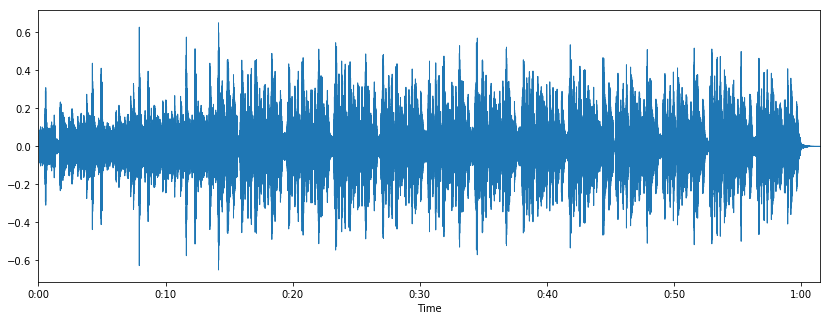

In [5]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(y, sr=sr)

In [6]:
def iir_bandpass(signal, freq, Q, fs):
    b, a = iirnotch(freq, Q, fs)
    y = lfilter(b, a, signal)
    return y

In [25]:
from scipy import signal

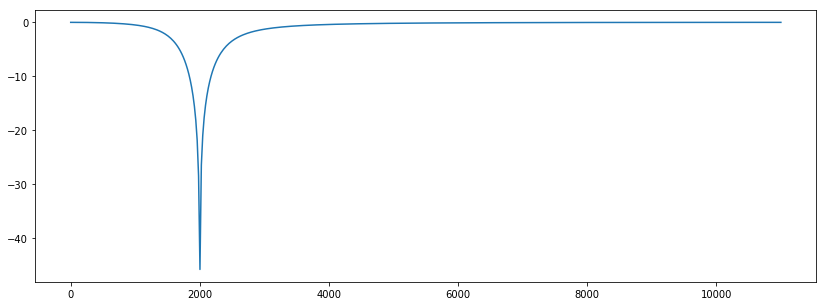

In [29]:
b, a = iirnotch(2000, 2, sr)
freq, h = signal.freqz(b, a, fs=sr)
plt.figure(figsize=(14,5))
plt.plot(freq, 20*np.log10(abs(h)))

In [33]:
b*10**(-3/20)

array([ 0.61913257, -1.04256116,  0.61913257])

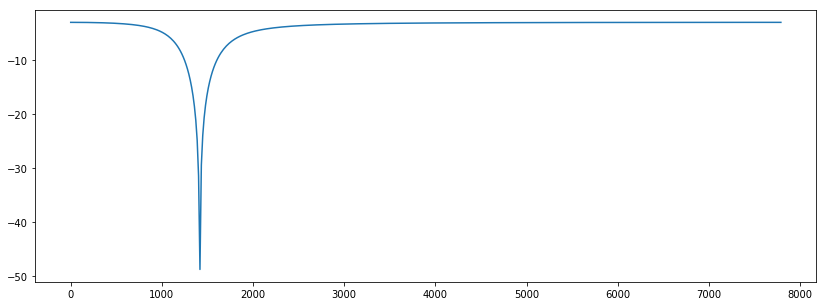

In [36]:
b, a = iirnotch(2000, 2, sr)
freq, h = signal.freqz(b, a, fs=sr)
h1 = h *10**(-3/20)
plt.figure(figsize=(14,5))
plt.plot(freq1, 20*np.log10(abs(h1)))

In [12]:
f = iir_bandpass(y, 2000, 2, sr)

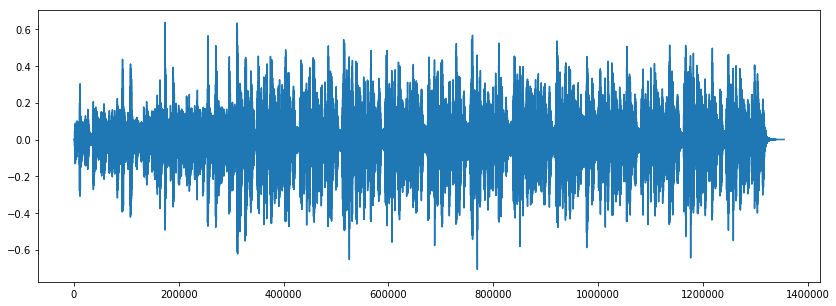

In [14]:
plt.figure(figsize=(14,5))
plt.plot(f)

In [17]:
(f-y)[:-30]

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
       5.04457294e-41, 6.72686352e-41, 6.12749171e-41])

In [9]:
ipd.Audio(filename)

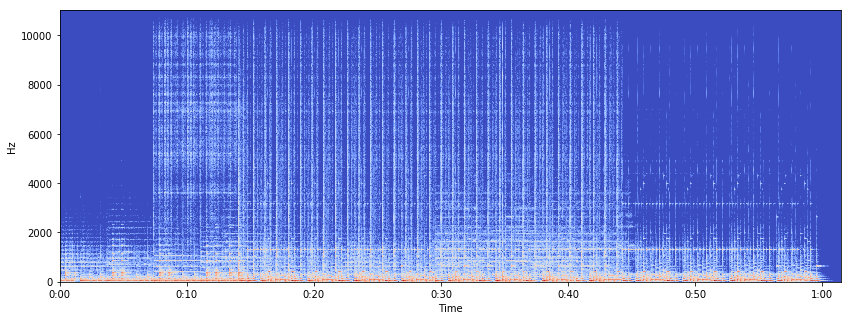

In [21]:
sf = librosa.stft(y)
sf_f = librosa.stft(f)
sfdb = librosa.amplitude_to_db(abs(sf))
sf_fdb = librosa.amplitude_to_db(abs(sf_f))
plt.figure(figsize=(14, 5))
librosa.display.specshow(sfdb, sr=sr, x_axis='time', y_axis='hz')

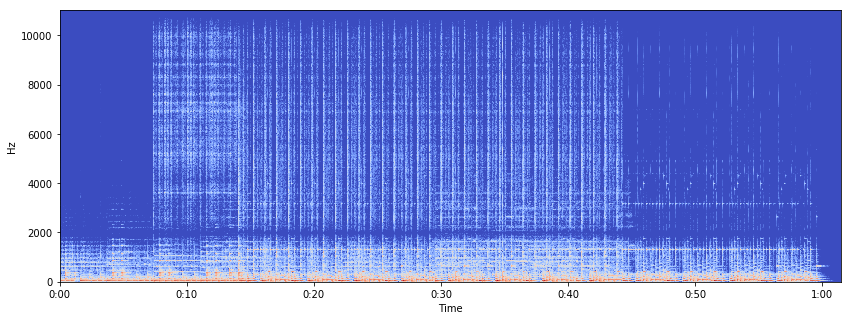

In [20]:
plt.figure(figsize=(14, 5))
librosa.display.specshow(sf_fdb, sr=sr, x_axis='time', y_axis='hz')

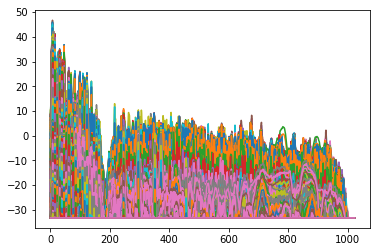

In [23]:
plt.figure()
plt.plot(sf_fdb)
plt.show()

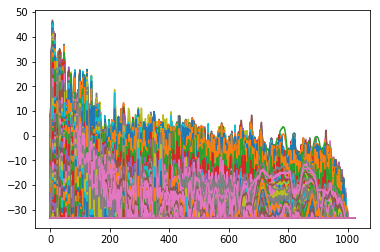

In [24]:
plt.figure()
plt.plot(sfdb)
plt.show()

In [15]:
x = offline_fmag(filename)

In [16]:
x.shape

(1324,)

In [28]:
def rank_freq_regions(audio_signal): return rankdata(audio_signal)

In [29]:
rank_freq_regions(x)

array([  4.,  65., 384., ...,   3.,   2.,   1.])

In [11]:
y, sr = librosa.load(filename)

In [12]:
1324 * 1024

1355776

In [34]:
y.shape, sr

((1355168,), 22050)

In [57]:
y_pad.shape

(1367100,)

In [58]:
D = np.abs(librosa.core.stft(y_pad, hop_length=1024))

In [59]:
D.shape

(1025, 1336)

In [60]:
1025*1336

1369400

In [62]:
F = np.mean(D, axis=0)

In [63]:
F.shape

(1336,)